In [106]:
import os.path
import pandas as pd
import numpy as np
from BioNNDatasets import CustomTranscriptomicsDataset
from BioDataParser import GPRMapParser, Stoichiometry
from torch.utils.data import DataLoader, ConcatDataset
import torch
from scipy.spatial.distance import pdist, squareform
import plotly.express as px




In [107]:
normal_dataset = CustomTranscriptomicsDataset(
        annotations_file="./Human Tumors Dataset/Normal Samples Annotation.csv",
        dataset_dir="./Human Tumors Dataset/Normal Samples")

In [108]:
BATCH_SIZE=100

In [109]:
print(len(normal_dataset))

741


In [110]:
normal_dataset.dataset_labels

,Unnamed: 0,FileName,Label
0,0,TCGA-06-0675-11A-32R-A36H-07.csv,GBM
1,1,TCGA-06-0678-11A-32R-A36H-07.csv,GBM
2,2,TCGA-06-0680-11A-32R-A36H-07.csv,GBM
3,3,TCGA-06-0681-11A-41R-A36H-07.csv,GBM
4,4,TCGA-06-AABW-11A-31R-A36H-07.csv,GBM
...,...,...,...
736,736,TCGA-X7-A8D6-11A-22R-A42C-07.csv,THYM
737,737,TCGA-X7-A8D7-11A-11R-A42C-07.csv,THYM
738,738,TCGA-Y8-A8RY-11A-11R-A37K-07.csv,KIRP
739,739,TCGA-YB-A89D-11A-11R-A36G-07.csv,PAAD


In [111]:
len(normal_dataset[0][0])

1713

In [112]:
column_names=list(np.arange(1713))
column_names.append("target")
print(column_names)

[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221,

In [113]:
column_types=["float64" for _ in range(len(column_names)-1)]
column_types.append("category")
len(column_types)

1714

In [114]:
df=pd.DataFrame(np.column_stack(list(zip(*iter(normal_dataset)))),columns=column_names)
df.head()

,0,1,2,3,4,5,6,7,8,9,...,1704,1705,1706,1707,1708,1709,1710,1711,1712,target
0,0.807138149971099,0.555169701875436,0.0,0.230194097789604,0.0923686855782214,6.50988780982307,0.0,0.0,0.29914736487602,3.37056737712036,...,0.232780319518132,4.68795427014603,0.492558719738491,49.372986445792,0.239485663875583,6.50512824808256,0.596176728121765,0.954578771617937,18.4505500914958,GBM
1,0.972711240426142,0.623705372808582,0.0,0.125323530589599,0.142634672611532,40.5393910685004,0.0,0.0154077414231369,0.179589961682688,3.43825313172263,...,1.23834814764443,26.2370448950377,0.115644652918488,40.0304335416893,0.230962569794304,5.79185690636892,0.756066021824005,0.796645206716948,17.8502209033772,GBM
2,0.744510843411995,0.577455029674616,0.0,0.167787946616207,0.144363285488986,5.31313828737399,0.0,0.0,0.665726627177921,3.89699117189971,...,0.481436796528472,4.68622498042573,0.285517657937514,48.4549998159655,0.19863786461545,6.19061262457214,0.793299507293977,1.18137292359582,18.9286131797932,GBM
3,0.89075750042391,0.814211011325755,0.0,0.102915801359341,0.194280990312398,9.56085548959292,0.0,0.0118620485333006,0.349721479657934,2.36943719709373,...,0.501775986126005,4.36771278114,0.325160454764683,43.1033476651349,0.186416343605584,6.30765185341501,1.4110957482771,1.1275137739164,18.9421409131016,GBM
4,0.479532246841934,0.29522298008146,0.0,0.0686473844196857,0.12620961018117,1.87301221365143,0.0,0.0,0.156238576665292,4.96228908326528,...,0.142804049372416,2.97178966668327,0.0950185041982302,35.7139494455687,0.0244862643019461,2.88097176959085,0.301195442505046,0.528935081131686,17.1958557241307,GBM


In [115]:
df=pd.concat([df.iloc[:,:-1].astype("float64"),df.iloc[:,-1].astype("category")],axis=1)
df.dtypes


0          float64
1          float64
2          float64
3          float64
4          float64
            ...   
1709       float64
1710       float64
1711       float64
1712       float64
target    category
Length: 1714, dtype: object

In [116]:
df_x=df.iloc[:,:-1]

In [117]:
df_stats=df.describe(percentiles=[0.25, 0.5, 0.75, 0.9])


In [118]:
df_stats.shape

(9, 1713)

In [119]:
df_stats.to_numpy()[1].shape

(1713,)

In [120]:
px.line(df_stats.transpose(),range_y=(0,400))

In [121]:
px.imshow(df[:-2],zmin=0.0,zmax=100.0,aspect="auto",text_auto=True)


In [122]:
df_x

,0,1,2,3,4,5,6,7,8,9,...,1703,1704,1705,1706,1707,1708,1709,1710,1711,1712
0,0.807138,0.555170,0.0,0.230194,0.092369,6.509888,0.0,0.000000,0.299147,3.370567,...,0.000000,0.232780,4.687954,0.492559,49.372986,0.239486,6.505128,0.596177,0.954579,18.450550
1,0.972711,0.623705,0.0,0.125324,0.142635,40.539391,0.0,0.015408,0.179590,3.438253,...,0.015236,1.238348,26.237045,0.115645,40.030434,0.230963,5.791857,0.756066,0.796645,17.850221
2,0.744511,0.577455,0.0,0.167788,0.144363,5.313138,0.0,0.000000,0.665727,3.896991,...,0.000000,0.481437,4.686225,0.285518,48.455000,0.198638,6.190613,0.793300,1.181373,18.928613
3,0.890758,0.814211,0.0,0.102916,0.194281,9.560855,0.0,0.011862,0.349721,2.369437,...,0.023459,0.501776,4.367713,0.325160,43.103348,0.186416,6.307652,1.411096,1.127514,18.942141
4,0.479532,0.295223,0.0,0.068647,0.126210,1.873012,0.0,0.000000,0.156239,4.962289,...,0.000000,0.142804,2.971790,0.095019,35.713949,0.024486,2.880972,0.301195,0.528935,17.195856
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
736,2.581380,269.889087,0.0,0.110861,0.214913,0.666444,0.0,0.019471,0.186900,4.768073,...,0.125148,183.356149,110.074966,233.540816,14.229547,0.174181,2.416595,3.503320,1.220280,18.628120
737,0.399713,8.167787,0.0,0.095598,0.280624,0.400757,0.0,0.000000,0.085325,3.813634,...,0.194839,4.518415,499.782104,12.206850,14.628001,0.147932,1.195589,1.079453,0.417042,36.711351
738,0.550595,5.392382,0.0,0.350997,0.731357,0.095291,0.0,0.043153,0.094679,9.326651,...,0.000000,10.331806,474.978939,3.717682,17.433332,30.342043,20.214366,3.336720,16.163696,32.484968
739,1.173765,44.586365,0.0,0.207629,3.632592,25.788701,0.0,0.148219,0.025406,3.695680,...,0.000000,18.008320,25.358763,98.168152,3.144304,0.068685,3.460249,1.708101,1.986851,14.806922


In [123]:
np.percentile(df_x.to_numpy(), 25)

0.425221910468647

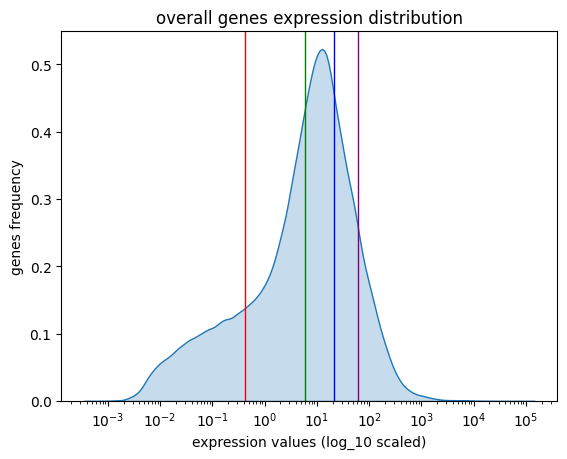

In [128]:
import seaborn as sns
import matplotlib.pyplot as plt
fig, ax = plt.subplots()

overall_gene_expressions=df_x.to_numpy().flatten()
overall_gene_expressions_nonzero=overall_gene_expressions[overall_gene_expressions.nonzero()]
# overall_gene_exprresions_non_zero_log_scale=np.log(overall_gene_exprresions_nonzero)

sns.kdeplot(overall_gene_expressions_nonzero,ax=ax,log_scale=True,fill=True,common_grid=True,palette="crest")
ax.axvline(np.percentile(overall_gene_expressions, 25),linewidth=1, color = "red")
ax.axvline(np.percentile(overall_gene_expressions, 50),linewidth=1, color = "green")
ax.axvline(np.percentile(overall_gene_expressions, 75),linewidth=1, color = "blue")
ax.axvline(np.percentile(overall_gene_expressions, 90),linewidth=1, color = "purple",)


ax.set_title("overall genes expression distribution")
ax.set_xlabel("expression values (log_10 scaled)")
ax.set_ylabel("genes frequency")


plt.show()

In [125]:
df.shape

(741, 1714)

In [126]:
from Preprocessor import Preprocessor
gpr_info=GPRMapParser(gpr_data_filepath="./Data/Cmp_Map.txt")
p=Preprocessor(gpr_info=gpr_info,number_of_features=df.shape[1],data=normal_dataset)

In [127]:
active_genes=p.apply_tresholding(approach="local",number_of_states=3,use_boundaries=True)

TypeError: '<' not supported between instances of 'str' and 'float'

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 741 entries, 0 to 740
Columns: 1714 entries, 0 to target
dtypes: category(1), float64(1713)
memory usage: 9.7 MB


In [ ]:
normal_dataloader = DataLoader(normal_dataset, batch_size=BATCH_SIZE)


In [ ]:
for i in normal_dataloader.sampler:
    print(i)
    break

0


In [ ]:
for x, p in normal_dataloader:
            
            x = x.float()
            print(x.shape)
            print(len(p))
            print(x)
            break


torch.Size([100, 1713])
100
tensor([[  0.8071,   0.5552,   0.0000,  ...,   0.5962,   0.9546,  18.4506],
        [  0.9727,   0.6237,   0.0000,  ...,   0.7561,   0.7966,  17.8502],
        [  0.7445,   0.5775,   0.0000,  ...,   0.7933,   1.1814,  18.9286],
        ...,
        [  1.0165, 102.9120,   0.0000,  ...,  21.4459,   1.3980,   8.4818],
        [  0.7178,  89.0628,   0.0000,  ...,  16.6044,   0.4789,  10.2596],
        [  0.2979,  87.4317,   0.0000,  ...,  29.9538,   0.4829,   8.7349]])
